In [18]:
# The conda env used in this notebook is a customised "crc-atlas env.: contains scanpy_helper_submodule from the LUCAS project
import os
import anndata as ad
import decoupler as dc
import numpy as np
import pandas as pd
import sc_atlas_helpers as ah
import scanpy as sc
from matplotlib.pyplot import rc_context
from scanpy_helper_submodule import scanpy_helpers as sh

# Figure default parameters
sc.settings.set_figure_params(
    dpi=400,
    facecolor="white",
    frameon=False,
)

# Set the number of max CPUs to be used by the processes
from threadpoolctl import threadpool_limits

cpus = 4
threadpool_limits(cpus)

### 1. Neutrophil cluster annotation - MUI datasets 

In [15]:
# This h5ad was produced by Valentin after integrating the datasets with var. genes = 100
adata_mui = sc.read_h5ad(
    "/data/projects/2022/CRCA/results/v1/artifacts/build_atlas/load_datasets/MUI_Innsbruck_neutro_hvg100.h5ad"
)

In [4]:
# Load in the AbSeq data
adata_abseq = sc.read_h5ad(
    "/data/projects/2022/CRCA/results/v1/artifacts/build_atlas/load_datasets/mui_innsbruck_abseq/artifacts/MUI_Innsbruck_AbSeq-adata.h5ad"
)

In [21]:
# merge
adata_neutro_mui = ad.concat([adata_mui, adata_abseq], merge='same')

# subset for neutro
# adata_neutro_mui = adata_neutro_mui[adata_neutro_mui.obs["cell_type_coarse"].isin(["Neutrophil"])]
adata_neutro_mui

AnnData object with n_obs × n_vars = 1196185 × 17190
    obs: 'study_id', 'dataset', 'sample_id', 'sample_type', 'sample_tissue', 'patient_id', 'platform', 'reference_genome', 'matrix_type', 'enrichment_cell_types', 'tissue_cell_state', 'tissue_processing_lab', 'country', 'hospital_location'
    var: 'ensembl'

/home/fotakis/.conda/envs/crc_atlas/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/fotakis/.conda/envs/crc_atlas/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:371: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/fotakis/.conda/envs/crc_atlas/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:381: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/fotakis/.conda/envs/crc_atlas/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Paramet

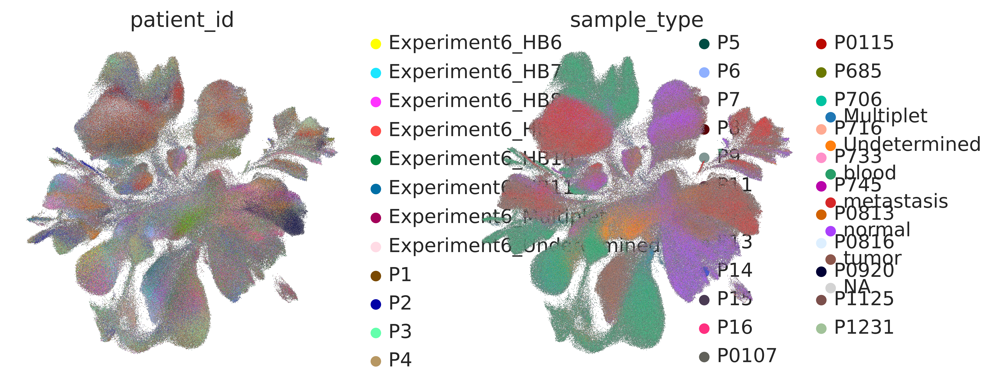

In [12]:
sc.pl.umap(
    adata_mui,
    color=["patient_id", "sample_type"],
    layer="log1p_norm",
    vmin=0,
    vmax="p99",
    sort_order=False,
    frameon=False,
    add_outline=True,
    # legend_loc="on data"
    # save="_all_neutro.png",
)